In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set_style('darkgrid')
pd.options.display.float_format = '{:.2f}'.format

# Geopandas
import geopandas
from geodatasets import get_path
import geodatasets

# Folium
import folium

# Plotly
import plotly.express as px
# plotly subplots
import plotly.subplots as sp
from plotly.subplots import make_subplots

# Cufflinks 
import cufflinks as cf

# Altair
import altair as alt

# Bokeh
import bokeh

# Panel (Dashboard)
import panel as pn

In [2]:
pn.extension('plotly')

In [3]:
df = pd.read_csv('hotel_booking.csv')

In [4]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,Transient,0.00,0,0,Check-Out,7/1/2015,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,Transient,0.00,0,0,Check-Out,7/1/2015,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,Transient,75.00,0,0,Check-Out,7/2/2015,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,Transient,75.00,0,0,Check-Out,7/2/2015,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,Transient,98.00,0,1,Check-Out,7/3/2015,Linda Hines,LHines@verizon.com,713-226-5883,************5498


In [5]:
df.tail()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
119385,City Hotel,0,23,2017,August,35,30,2,5,2,...,Transient,96.14,0,0,Check-Out,9/6/2017,Claudia Johnson,Claudia.J@yahoo.com,403-092-5582,************8647
119386,City Hotel,0,102,2017,August,35,31,2,5,3,...,Transient,225.43,0,2,Check-Out,9/7/2017,Wesley Aguilar,WAguilar@xfinity.com,238-763-0612,************4333
119387,City Hotel,0,34,2017,August,35,31,2,5,2,...,Transient,157.71,0,4,Check-Out,9/7/2017,Mary Morales,Mary_Morales@hotmail.com,395-518-4100,************1821
119388,City Hotel,0,109,2017,August,35,31,2,5,2,...,Transient,104.40,0,0,Check-Out,9/7/2017,Caroline Conley MD,MD_Caroline@comcast.net,531-528-1017,************7860
119389,City Hotel,0,205,2017,August,35,29,2,7,2,...,Transient,151.20,0,2,Check-Out,9/7/2017,Ariana Michael,Ariana_M@xfinity.com,422-804-6403,************4482


In [6]:
df.duplicated().sum()

0

In [7]:
print('Total number of observations before dropping:', df.shape[0])
before_drop = df.shape[1]
print('Total number of attributes before dropping:', before_drop)

Total number of observations before dropping: 119390
Total number of attributes before dropping: 36


In [8]:
print('Columns Before dropping:\n\n',df.columns)

Columns Before dropping:

 Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'name', 'email',
       'phone-number', 'credit_card'],
      dtype='object')


In [9]:
# Removing the unnecassary features from the dataset which are not relavent

df.drop(['name', 'email','phone-number', 'credit_card'],axis=1,inplace=True)

In [10]:
print('Columns after dropping:\n\n', df.columns)

Columns after dropping:

 Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date'],
      dtype='object')


In [11]:
print('Total number of attributes before dropping:', before_drop)
print('Total number of attributes after dropping:', df.shape[1])

Total number of attributes before dropping: 36
Total number of attributes after dropping: 32


# Exploratory Data Analysis

is_canceled
0    75166
1    44224
Name: count, dtype: int64

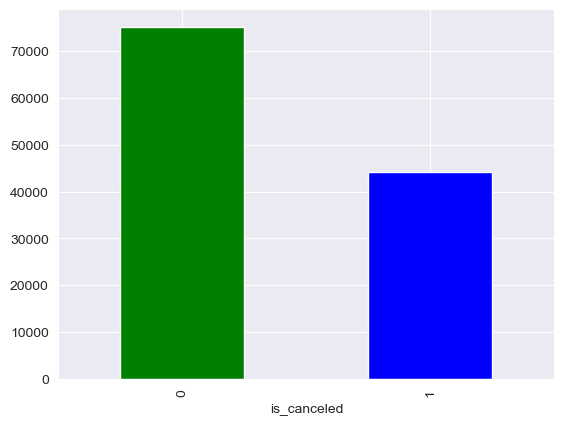

In [12]:
# Target Varaible 
colors= ['green','blue']
df['is_canceled'].value_counts().plot(kind='bar',color=colors);

df['is_canceled'].value_counts()

In [13]:
# From which Country the Guests come from?

country_arrival = df[df['is_canceled'] == 0]['country'].value_counts().reset_index()
country_arrival.columns = ['Country', 'Monthly Arrivals']

# Top 10 arrival countries
country_arrival.head(10)

,Country,Monthly Arrivals
0,PRT,21071
1,GBR,9676
2,FRA,8481
3,ESP,6391
4,DEU,6069
5,IRL,2543
6,ITA,2433
7,BEL,1868
8,NLD,1717
9,USA,1596


### Pie Chart

https://plotly.com/python/pie-charts/

In [14]:
top10_countries = country_arrival.head(10)

Top10CountriesPie = px.pie(top10_countries, names='Country', 
                           values='Monthly Arrivals',
                           title='Top 10 Arrival Countries',
                           color_discrete_sequence=px.colors.sequential.RdBu)

Top10CountriesPie.update_traces(textposition='inside', textinfo='percent+label')

Top10CountriesPie.show()

### Displaying Arrival Countries on the World Map

https://plotly.com/python/choropleth-maps/

In [15]:
ArrivalCountries = px.choropleth(country_arrival, 
                                 locations='Country',
                                 color='Monthly Arrivals',
                                 range_color=[20, 3000],
#                                  hover_name='Country',
                                 custom_data=['Country', 'Monthly Arrivals'])                   

ArrivalCountries.update_layout(title_text='Arrival Countries',
                               geo=dict(projection={'type': 'natural earth'}))

ArrivalCountries.show();

### Subsets Target Variable

In [16]:
df_resort = df[(df['hotel'] == 'Resort Hotel') & (df['is_canceled'] == 0)]
df_city = df[(df['hotel'] == 'City Hotel') & (df['is_canceled'] == 0)] 

### ADR fluctuations per nigh per hotel 

In [17]:
df['adr'].sort_values(ascending=False).head()

48515    5400.00
111403    510.00
15083     508.00
103912    451.50
13142     450.00
Name: adr, dtype: float64

In [18]:
# Dropping outlier with 'adr=5400' as is not representative.
df = df.drop(index=48515)

In [19]:
df['adr'].sort_values().head()

14969   -6.38
0        0.00
2534     0.00
2536     0.00
33283    0.00
Name: adr, dtype: float64

In [20]:
# Dropping negative 'adr=-6.38' as is not representative.
df = df.drop(index=14969)

### ADR Resort Hotel

In [21]:
adr_resort = df_resort.groupby('arrival_date_month')['adr'].mean().reset_index()
adr_resort

,arrival_date_month,adr
0,April,75.87
1,August,181.21
2,December,68.32
3,February,54.15
4,January,48.71
5,July,150.12
6,June,107.92
7,March,57.01
8,May,76.66
9,November,48.68


### ADR City Hotel

In [22]:
adr_city = df_city.groupby('arrival_date_month')['adr'].mean().reset_index()
adr_city

,arrival_date_month,adr
0,April,111.86
1,August,118.41
2,December,87.86
3,February,86.18
4,January,82.16
5,July,115.56
6,June,117.70
7,March,90.17
8,May,120.45
9,November,86.50


### Merged both ADR Hotels

In [23]:
adr_both_hotels = adr_resort.merge(adr_city, on='arrival_date_month')
adr_both_hotels.columns = ['Month', 'ADR Resort', 'ADR City']

adr_both_hotels

,Month,ADR Resort,ADR City
0,April,75.87,111.86
1,August,181.21,118.41
2,December,68.32,87.86
3,February,54.15,86.18
4,January,48.71,82.16
5,July,150.12,115.56
6,June,107.92,117.70
7,March,57.01,90.17
8,May,76.66,120.45
9,November,48.68,86.50


#### Sorting Months Chronologically 

In [24]:
### We need to sort the months accordingly for readability

month = ['January', 'February', 'March', 'April', 'May', 'June',
         'July', 'August', 'September', 'October', 'November', 'December']

adr_both_hotels['Month'] = pd.Categorical(adr_both_hotels['Month'], categories=month, ordered=True)

# Sort Months
adr_both_hotels.sort_values('Month', inplace=True)

adr_both_hotels

,Month,ADR Resort,ADR City
4,January,48.71,82.16
3,February,54.15,86.18
7,March,57.01,90.17
0,April,75.87,111.86
8,May,76.66,120.45
6,June,107.92,117.70
5,July,150.12,115.56
1,August,181.21,118.41
11,September,96.42,112.60
10,October,61.73,101.75


# Line charts

# Trends that change over time across the ADR.
* https://plotly.com/python/line-charts/

## Line Chart ADR

In [25]:
LineChartADR = px.line(adr_both_hotels, x='Month', y=['ADR City', 'ADR Resort'])

LineChartADR.update_traces(mode='lines+markers', marker=dict(size=12),
                           line=dict(width=3, color='purple'), selector=dict(name='ADR City'))

LineChartADR.update_traces(mode='lines+markers', marker=dict(size=12),
                           line=dict(width=3, color='green'), selector=dict(name='ADR Resort'))

LineChartADR.update_layout(title='Monthly ADR Comparison',
                           xaxis_title='Months',
                           yaxis_title='Average Daily Rate')

LineChartADR.show()

### Arrivals Resort Hotel

In [26]:
arrivals_resort = df_resort['arrival_date_month'].value_counts().reset_index()
arrivals_resort.columns=['Month','Arrivals Resort']
arrivals_resort

,Month,Arrivals Resort
0,August,3257
1,July,3137
2,October,2577
3,March,2573
4,April,2550
5,May,2535
6,February,2308
7,September,2102
8,June,2038
9,December,2017


### Arrivals City Hotel

In [27]:
arrivals_city = df_city['arrival_date_month'].value_counts().reset_index()
arrivals_city.columns=['Month','Arrivals City']
arrivals_city

,Month,Arrivals City
0,August,5381
1,July,4782
2,May,4579
3,June,4366
4,October,4337
5,September,4290
6,March,4072
7,April,4015
8,February,3064
9,November,2696


### Merged both Guests Hotels

In [28]:
both_arrivals = arrivals_resort.merge(arrivals_city, on='Month')
both_arrivals.columns = ['Month', 'Arrivals Resort', 'Arrivals City']
both_arrivals

,Month,Arrivals Resort,Arrivals City
0,August,3257,5381
1,July,3137,4782
2,October,2577,4337
3,March,2573,4072
4,April,2550,4015
5,May,2535,4579
6,February,2308,3064
7,September,2102,4290
8,June,2038,4366
9,December,2017,2392


#### Sorting Months Chronologically

In [29]:
# We need to sort the months accordingly for readability

month = ['January', 'February', 'March', 'April', 'May', 'June',
         'July', 'August', 'September', 'October', 'November', 'December']

both_arrivals['Month'] = pd.Categorical(both_arrivals['Month'], categories=month, ordered=True)

# Sort Months
both_arrivals.sort_values('Month', inplace=True)

both_arrivals

,Month,Arrivals Resort,Arrivals City
11,January,1868,2254
6,February,2308,3064
3,March,2573,4072
4,April,2550,4015
5,May,2535,4579
8,June,2038,4366
1,July,3137,4782
0,August,3257,5381
7,September,2102,4290
2,October,2577,4337


## Line Chart Arrivals

In [30]:
LineChartArrivals = px.line(both_arrivals, x='Month', y=['Arrivals City', 'Arrivals Resort'])

LineChartArrivals.update_traces(mode='lines+markers', marker=dict(size=12),
                              line=dict(width=3, color='purple'), selector=dict(name='Arrivals City'))

LineChartArrivals.update_traces(mode='lines+markers', marker=dict(size=12),
                              line=dict(width=3, color='green'), selector=dict(name='Arrivals Resort'))

LineChartArrivals.update_layout(title='Monthly Arrivals Comparison',
                              xaxis_title='Months',
                              yaxis_title='Arrivals')

LineChartArrivals.show()

# Histograms 

# Distribution for Categorical Variables 
* https://plotly.com/python/histograms/

### Market Segment 

In [31]:
MarketSegment = px.histogram(df, 
                         x='market_segment',
                         color='is_canceled',
                         barmode='group',
                         title='Market Segment',
                         labels={'market_segment': 'Market Segment'},
                         animation_frame='arrival_date_month',
                         category_orders={'arrival_date_month': ['January', 'February', 'March', 'April', 'May', 'June',
                                                                 'July', 'August', 'September', 'October', 'November',
                                                                 'December']},
                         color_discrete_map={0: 'darkolivegreen', 1: 'darkorange'}  
                         )

MarketSegment.show()

### CustomerType

In [32]:
CustomerType = px.histogram(df, 
                         x='customer_type',
                         color='is_canceled',
                         barmode='group',
                         title='Customer Type',
                         labels={'customer_type': 'Customer Type'},
                         animation_frame='arrival_date_month',
                         category_orders={'arrival_date_month': ['January', 'February', 'March', 'April', 'May', 'June',
                                                                 'July', 'August', 'September', 'October', 'November',
                                                                 'December']},
                         color_discrete_map={0: 'darkolivegreen', 1: 'darkorange'}  
                         )

CustomerType.show()

# Box Plot 

# Distribution of the target variable for Categorical Variables

In [33]:
# total_night column was added for analysis
df['total_nights'] = df['stays_in_weekend_nights'] + df['stays_in_week_nights']
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_nights
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,NaN,NaN,0,Transient,0.00,0,0,Check-Out,7/1/2015,0
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,NaN,NaN,0,Transient,0.00,0,0,Check-Out,7/1/2015,0
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,NaN,NaN,0,Transient,75.00,0,0,Check-Out,7/2/2015,1
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,304.00,NaN,0,Transient,75.00,0,0,Check-Out,7/2/2015,1
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,240.00,NaN,0,Transient,98.00,0,1,Check-Out,7/3/2015,2


In [34]:
(df['total_nights'] == 0).sum()

715

In [35]:
boxplot = sp.make_subplots(rows=1, cols=5,
                           subplot_titles=['Lead Time', 'Week Nº', 'Month Day',
                                           'ADR', 'Total Nights'])
                                       
box1 = px.box(df, x='is_canceled', y='lead_time', color='is_canceled')
box2 = px.box(df, x='is_canceled', y='arrival_date_week_number', color='is_canceled')
box3 = px.box(df, x='is_canceled', y='arrival_date_day_of_month', color='is_canceled')
box4 = px.box(df, x='is_canceled', y='adr', color='is_canceled')
box5 = px.box(df, x='is_canceled', y='total_nights', color='is_canceled')

# No Canceled
boxplot.add_trace(box1['data'][0], row=1, col=1)
boxplot.add_trace(box2['data'][0], row=1, col=2)
boxplot.add_trace(box3['data'][0], row=1, col=3)
boxplot.add_trace(box4['data'][0], row=1, col=4)
boxplot.add_trace(box5['data'][0], row=1, col=5)

# Canceled
boxplot.add_trace(box1['data'][1], row=1, col=1)
boxplot.add_trace(box2['data'][1], row=1, col=2)
boxplot.add_trace(box3['data'][1], row=1, col=3)
boxplot.add_trace(box4['data'][1], row=1, col=4)
boxplot.add_trace(box5['data'][1], row=1, col=5)

boxplot.update_layout(title_text='Features Vs. Target Variable')
boxplot.show()

## ADR Room Type

In [36]:
BoxPlotRoom = px.box(data_frame = df, x = 'reserved_room_type', y = 'adr', color = 'hotel',
                     color_discrete_map={'City Hotel': 'darkblue', 'Resort Hotel': 'green'})

BoxPlotRoom.update_layout(title='ADR Room Type',
                          xaxis_title='Reserved Room Type',
                          yaxis_title='ADR',
                          showlegend=True)

BoxPlotRoom.show()

# Dashboard

In [37]:
dashboard = pn.Column(
    pn.pane.Markdown('# Hotel Booking Dashboard Analysis'),
    pn.Row(pn.Column(ArrivalCountries), pn.Column(Top10CountriesPie)),
    pn.Row(pn.Column(LineChartArrivals), pn.Column(LineChartADR)),
    pn.Row(pn.Column(boxplot), pn.Column(BoxPlotRoom)),
    pn.Row(pn.Column(MarketSegment), pn.Column(CustomerType))
)

In [38]:
dashboard.servable()

Column
    [0] Markdown(str)
    [1] Row
        [0] Column
            [0] Plotly(Figure)
        [1] Column
            [0] Plotly(Figure)
    [2] Row
        [0] Column
            [0] Plotly(Figure)
        [1] Column
            [0] Plotly(Figure)
    [3] Row
        [0] Column
            [0] Plotly(Figure)
        [1] Column
            [0] Plotly(Figure)
    [4] Row
        [0] Column
            [0] Plotly(Figure)
        [1] Column
            [0] Plotly(Figure)